##Training the models

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.regularizers import l2
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l1
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report
from sklearn.model_selection import StratifiedKFold
from sklearn.linear_model import LogisticRegression
import matplotlib.pyplot as plt
import numpy as np
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.metrics import confusion_matrix
import seaborn as sns
from sklearn.model_selection import GridSearchCV
import shap
from sklearn.model_selection import ShuffleSplit
from sklearn.model_selection import learning_curve
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
import xgboost as xgb

We have defined a function that we will use a lot in order to see if there is overfitting plot_learning_curve as it is named it shows a learning curve of the training data and the test data.

In [ ]:
def plot_learning_curve(estimator, title, X, y,type_label, ylim=None, cv=None,
                        n_jobs=None, train_sizes=np.linspace(.1, 1.0, 5)):
    plt.figure()
    plt.title(title)
    if ylim is not None:
        plt.ylim(*ylim)
    plt.xlabel("Training examples")
    plt.ylabel("Score")
    train_sizes, train_scores, test_scores = learning_curve(
        estimator, X, y, cv=cv, n_jobs=n_jobs, train_sizes=train_sizes)
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    plt.grid()

    plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                     train_scores_mean + train_scores_std, alpha=0.1,
                     color="r")
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                     test_scores_mean + test_scores_std, alpha=0.1, color="g")
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r",
             label="Training score")
    plt.plot(train_sizes, test_scores_mean, 'o-', color="g",
             label=type_label)

    plt.legend(loc="best")
    return plt

##**for pca**

In [ ]:
X_train, X_test, y_train, y_test = pca_df_train, pca_df_test, pca_group_train, pca_group_test

####**Regression**

Logistic regression is a statistical model used for binary classification tasks. It estimates the probability that a given input belongs to a certain category, usually using a logistic function. The model computes a weighted sum of input features, applies a logistic transformation to constrain the output between 0 and 1, and assigns a class based on a specified threshold.

In [ ]:
model = LogisticRegression()

model.fit(pca_df_train, pca_group_train)

LogisticRegression()

In [ ]:
predictions = model.predict(pca_df_test)
accuracy = accuracy_score(pca_group_test, predictions)

print("Accuracy:", accuracy)

report = classification_report(y_test, predictions)
print("\nClassification Report:\n", report)


Accuracy: 0.7702702702702703

Classification Report:
               precision    recall  f1-score   support

           0       0.72      0.83      0.77        35
           1       0.82      0.72      0.77        39

    accuracy                           0.77        74
   macro avg       0.77      0.77      0.77        74
weighted avg       0.78      0.77      0.77        74



The logistic regression model gives us a relatively small percentage of success, we only got an accuracy of 77 percent. We think that the reason is that the true relationship is non-linear.

Logistic Regression assumes a linear relationship between the features and the log-odds of the target variable. If the true relationship is non-linear, Logistic Regression may struggle to capture it. so we will use a more complex model, like a Random Forest or  Gradient Boosting model, which can capture non-linear relationships more effectively.

Besides, we want to check if there isn't overfitting because we don't have big data, so we will use cross-validation techniques to get a more reliable estimate of the model's performance. This helps ensure that the model's performance is consistent across different subsets of the data

In [ ]:
model = LogisticRegression()

X = pca_df.drop(columns=['Group'])
y = pca_df['Group']

#cross-validation
cv_scores = cross_val_score(model, X, y, cv=19)
mean_cv_score = cv_scores.mean()
std_cv_score = cv_scores.std()

print("Cross-validation Scores:", cv_scores)
print(f"Mean Cross-validation Score: {mean_cv_score}")
print(f"Standard Deviation of Cross-validation Scores: {std_cv_score}")

Cross-validation Scores: [0.7        0.9        0.9        0.9        0.85       0.8
 0.73684211 0.84210526 0.89473684 0.57894737 0.68421053 0.84210526
 0.63157895 0.73684211 0.52631579 0.84210526 0.78947368 0.73684211
 0.89473684]
Mean Cross-validation Score: 0.7782548476454293
Standard Deviation of Cross-validation Scores: 0.11107186986367537


The accuracy remains exactly the same so it seems that the main problem is not overfitting. But the model is too simple.

We will check using a visual graph the differences between accuracy in test data and accuracy in training data.

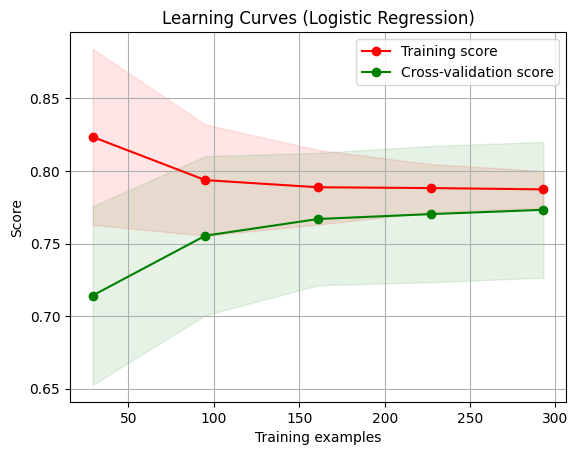

In [ ]:
title = "Learning Curves (Logistic Regression)"
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)
estimator = LogisticRegression(max_iter=1000)
plot_learning_curve(estimator, title, X, y, type_label="Cross-validation score", cv=cv, n_jobs=-1)
plt.show()

We get a distance between the accuracy of the test data and the accuracy of the training data, but it doesn't seem like a very big distance (maybe that's why cross-validation didn't improve the accuracy) so it's more reasonable to assume that the main problem is not overfitting. But the model is too simple.

We will use stronger algorithms.

####**XGBoost Classifier**

The XGBClassifier is an implementation of the gradient boosting algorithm, which is specialized for classification tasks. It builds an ensemble of decision trees in sequence, with each successive tree correcting the errors of the previous one. During training, it minimizes a loss function, such as cross entropy, to improve prediction accuracy.

In [ ]:
model = xgb.XGBClassifier(n_estimators=150, learning_rate=0.1, random_state=42)
model.fit(X_train, y_train)

train_predictions = model.predict(X_train)
test_predictions = model.predict(X_test)

train_accuracy = accuracy_score(y_train, train_predictions)
test_accuracy = accuracy_score(y_test, test_predictions)
test_report = classification_report(y_test, test_predictions)

print("Training Accuracy:", train_accuracy)
print("Test Accuracy:", test_accuracy)
print("\nTest Classification Report:\n", test_report)

Training Accuracy: 1.0
Test Accuracy: 0.8243243243243243

Test Classification Report:
               precision    recall  f1-score   support

           0       0.81      0.83      0.82        35
           1       0.84      0.82      0.83        39

    accuracy                           0.82        74
   macro avg       0.82      0.82      0.82        74
weighted avg       0.82      0.82      0.82        74



We got higher accuracy than the regression, so the assumption that the relationships are not linear is probably correct.

But it is still too low.

let's see if there is overfitting.

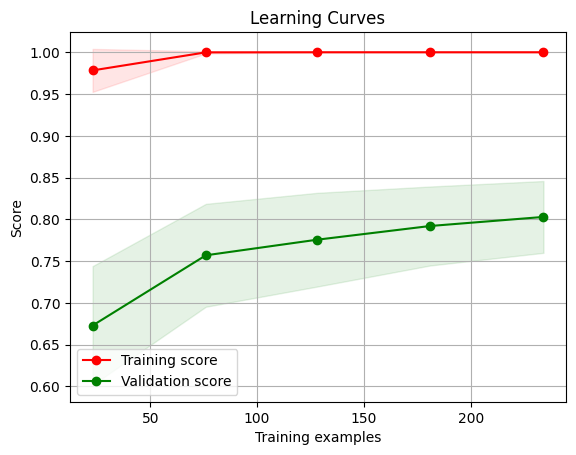

In [ ]:
title = "Learning Curves"
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)
plot_learning_curve(model, title, X_train, y_train, type_label="Validation score", cv=cv, n_jobs=-1)
plt.show()

We got a very problematic overmatch. We will try to solve this in several ways:



1.   Limiting the depth of the tree - did not work
2.   Increasing the minimum child weight - did not work
3.  Early stop - did not work
4. Regulation - did not work
5. cross-validation - did not help
6. Reducing the complexity of the model, i.e. reducing the number of features.

With the help of shap we will find the least significant feature and try to run XGBoost without it.

[10:52:41] WARNING: /workspace/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.


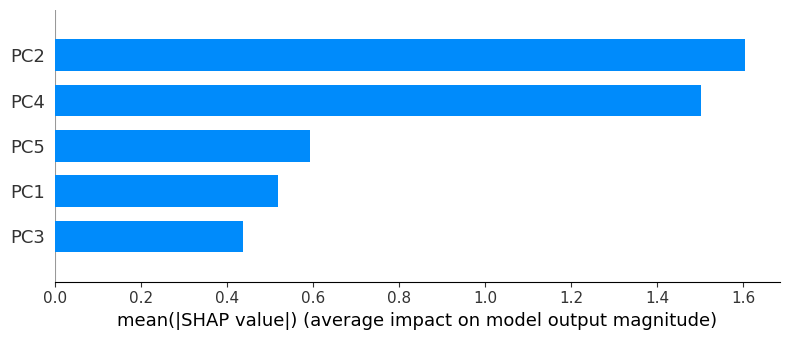

In [ ]:
explainer = shap.Explainer(model)
shap_values = explainer(X_test)
shap.summary_plot(shap_values, X_test, plot_type="bar")

According to the histogram, the component that has the least effect is PC3, so we will try to download it and run without it, maybe we will get an improvement in the results and overfitting.

In [ ]:
X_train_xg = X_train.drop(columns=['PC3'])
X_test_xg = X_test.drop(columns=['PC3'])

In [ ]:
model = xgb.XGBClassifier(n_estimators=150, learning_rate=0.3, random_state=42)
model.fit(X_train_xg, y_train)

train_predictions = model.predict(X_train_xg)
test_predictions = model.predict(X_test_xg)

train_accuracy = accuracy_score(y_train, train_predictions)
test_accuracy = accuracy_score(y_test, test_predictions)
test_report = classification_report(y_test, test_predictions)

print("Training Accuracy:", train_accuracy)
print("Test Accuracy:", test_accuracy)
print("\nTest Classification Report:\n", test_report)

Training Accuracy: 1.0
Test Accuracy: 0.8108108108108109

Test Classification Report:
               precision    recall  f1-score   support

           0       0.80      0.80      0.80        35
           1       0.82      0.82      0.82        39

    accuracy                           0.81        74
   macro avg       0.81      0.81      0.81        74
weighted avg       0.81      0.81      0.81        74



Unfortunately downloading a component didn't help us get better results. On the contrary, the accuracy decreased.
So let's go back to the first model. We will examine its results(We ran the model above again to update the variable test_predictions).

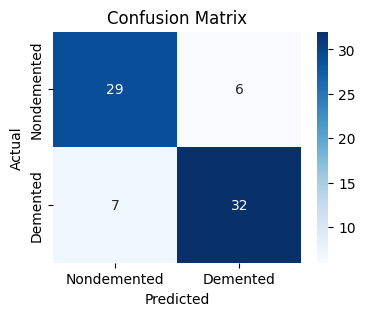

In [ ]:
conf_matrix = confusion_matrix(y_test, test_predictions)
plt.figure(figsize=(4, 3))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Nondemented', 'Demented'],
            yticklabels=['Nondemented', 'Demented'])

plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

The results are bad. We only got 82 percent. with a very problematic overfitting. And you can see it in the matrix.

We will have to find another algorithm:(

####**Random Forest Classifier**

Random Forest is also an ensemble learning method, but it operates differently from gradient boosting.



The RandomForestClassifier is an ensemble learning algorithm used for classification tasks. It builds a collection of decision trees, each trained on a random subset of the data and a random subset of features. This diversity among trees helps prevent overfitting and improves overall accuracy. During training, it uses bootstrapping to randomize the data with replacement, and it also randomly selects features at each split of the tree. When making predictions, each tree votes for the predicted class, and the most popular class becomes the final prediction.

In [ ]:
model = RandomForestClassifier(n_estimators=50, random_state=40)
model.fit(X_train, y_train)

train_predictions = model.predict(X_train)
train_accuracy = accuracy_score(y_train, train_predictions)

test_predictions = model.predict(X_test)
test_accuracy = accuracy_score(y_test, test_predictions)
test_report = classification_report(y_test, test_predictions)

print("Training Accuracy:", train_accuracy)
print("Test Accuracy:", test_accuracy)
print("\nTest Classification Report:\n", test_report)

Training Accuracy: 1.0
Test Accuracy: 0.8513513513513513

Test Classification Report:
               precision    recall  f1-score   support

           0       0.80      0.91      0.85        35
           1       0.91      0.79      0.85        39

    accuracy                           0.85        74
   macro avg       0.86      0.85      0.85        74
weighted avg       0.86      0.85      0.85        74



The accuracy of the training data is 0.99
And the accuracy of the test data is 0.85.

This means that there is a serious overfitting here. We will also see this visually in the following graph.



                                                  ⬇⬇⬇⬇⬇⬇⬇⬇⬇⬇⬇⬇⬇⬇

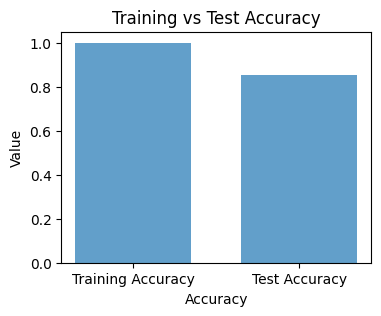

In [ ]:
labels = ['Training Accuracy', 'Test Accuracy']

accuracy_values = [train_accuracy, test_accuracy]
x = np.arange(len(labels))

plt.figure(figsize=(4, 3))
plt.bar(x, accuracy_values, width=0.7, align='center', alpha=0.7)
plt.xlabel('Accuracy')
plt.ylabel('Value')
plt.title('Training vs Test Accuracy')
plt.xticks(x, labels)
plt.show()



There are several hyperparameters that can be tuned to hopefully optimize its performance. We will use a grid search that includes specifying a grid of hyperparameter values and evaluating the model's performance for each combination of these values. The hyperparameters chosen for testing are:

- n_estimators - the number of trees in the forest. Increasing the number of trees generally improves performance, but unfortunately, it also increases computation time.
- min_samples_split - the minimum number of samples required to split an internal node.
- max_depth - the maximum depth of the trees. This controls the maximum number of levels in each decision tree.
- Criterion - the function to measure the quality of a split



In addition, we will also use cross-validation to minimize the overfitting.

In [ ]:
param_grid = {
    'n_estimators': [50, 150, 100, 200],
    'max_depth': [None, 5, 10],
    'min_samples_split': [2, 5, 10],
    'criterion': ['gini', 'entropy']
}

rf_classifier = RandomForestClassifier()
grid_search = GridSearchCV(rf_classifier, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_train, y_train)

# best hyperparameters
best_params = grid_search.best_params_
print("Best Hyperparameters:", best_params)

# Calculate accuracy of the best model on training data and test data
best_model = grid_search.best_estimator_
#train data
train_predictions = best_model.predict(X_train)
train_accuracy = accuracy_score(y_train, train_predictions)
#test data
test_predictions = best_model.predict(X_test)
test_accuracy = accuracy_score(y_test, test_predictions)
test_report = classification_report(y_test, test_predictions)

print("Training Accuracy:", train_accuracy)
print("Test Accuracy:", test_accuracy)
print("\nTest Classification Report:\n", test_report)

Best Hyperparameters: {'criterion': 'gini', 'max_depth': None, 'min_samples_split': 2, 'n_estimators': 100}
Training Accuracy: 1.0
Test Accuracy: 0.8513513513513513

Test Classification Report:
               precision    recall  f1-score   support

           0       0.82      0.89      0.85        35
           1       0.89      0.82      0.85        39

    accuracy                           0.85        74
   macro avg       0.85      0.85      0.85        74
weighted avg       0.85      0.85      0.85        74



Unfortunately, 85 percent seems to be the maximum we can  to reach on this model. Because grid searc and cross-validation are doomed to failure, and they fail to improve performance.

We will still try to examine the results we received.

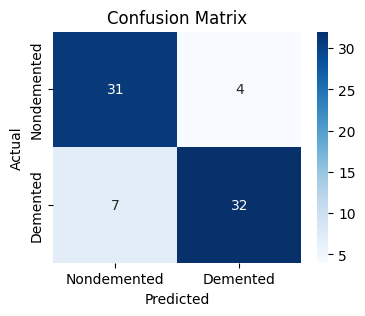

In [ ]:
conf_matrix = confusion_matrix(y_test, test_predictions)
plt.figure(figsize=(4, 3))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Nondemented', 'Demented'],
            yticklabels=['Nondemented', 'Demented'])

plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

We see 7 observations are FP and 4 observations TN. A total of 11 errors.

We would like to find out where he failed and why precisely in these observations. The first thing is to find out which observations were misclassified.

In [ ]:
misclassified_rf_df = pd.DataFrame({
    'index': X_test.index,
    'True_Label': y_test,
    'Predicted_Label': test_predictions
})

# Filter out the misclassified instances
misclassified_rf_df = misclassified_rf_df[misclassified_rf_df['True_Label'] != misclassified_rf_df['Predicted_Label']]
misclassified_rf_df.reset_index(drop=True, inplace=True)
print("Misclassified Instances:")
misclassified_rf_df

Misclassified Instances:


,index,True_Label,Predicted_Label
0,18,1,0
1,274,1,0
2,289,1,0
3,265,1,0
4,255,1,0
5,163,0,1
6,162,0,1
7,139,0,1
8,27,1,0
9,260,0,1


We received 11 observations.

We would like to get the values of the features after normalization (those on which the training was actually done): misclassified_rf_df

In [ ]:
misclassified_rf_df = pd.merge(pca_df, misclassified_rf_df, left_index=True, right_on='index')
misclassified_rf_df.drop(['Group'], axis=1, inplace=True)
misclassified_rf_df

,PC1,PC2,PC3,PC4,PC5,index,True_Label,Predicted_Label
0,1.029611,-0.108002,-1.258594,-0.419480,0.670234,18,1,0
8,-1.122287,3.728019,0.183570,-1.258464,-0.160257,27,1,0
7,0.390364,1.305752,-1.121742,-0.400747,-1.189230,139,0,1
6,-2.421995,0.294475,1.670625,-0.296516,-0.524118,162,0,1
5,-2.528614,0.400477,1.875950,-0.415554,-0.500814,163,0,1
4,-2.187190,-1.104049,0.194450,0.073922,-0.473746,255,1,0
9,0.999975,-1.583718,0.561643,0.600730,0.305145,260,0,1
3,1.797851,-0.907698,-0.876870,0.108996,0.094573,265,1,0
10,-1.899248,-0.751308,-0.695464,0.253293,-0.405617,273,1,0
1,-1.862345,-0.999191,-0.563867,-0.227636,-0.626596,274,1,0


We will use LIME (Local Explanations for Model-Agnostic Interpretation) to provide local interpretations of predictions made by the model about misclassified instances.

In [ ]:
from lime.lime_tabular import LimeTabularExplainer

X_features = pca_df.drop(columns=['Group'])
feature_names = X_features.columns

explainer = LimeTabularExplainer(X_features.values, mode="classification", feature_names=feature_names, training_labels=pca_df['Group'])
for i in misclassified_rf_df["index"].values:
  print(f"for the instance {i}")
  instance_index = i
  instance_features = X_features.iloc[instance_index].values
  explanation = explainer.explain_instance(instance_features, best_model.predict_proba)
  explanation.show_in_notebook()


for the instance 18


X does not have valid feature names, but RandomForestClassifier was fitted with feature names


for the instance 27


X does not have valid feature names, but RandomForestClassifier was fitted with feature names


for the instance 139


X does not have valid feature names, but RandomForestClassifier was fitted with feature names


for the instance 162


X does not have valid feature names, but RandomForestClassifier was fitted with feature names


for the instance 163


X does not have valid feature names, but RandomForestClassifier was fitted with feature names


for the instance 255


X does not have valid feature names, but RandomForestClassifier was fitted with feature names


for the instance 260


X does not have valid feature names, but RandomForestClassifier was fitted with feature names


for the instance 265


X does not have valid feature names, but RandomForestClassifier was fitted with feature names


for the instance 273


X does not have valid feature names, but RandomForestClassifier was fitted with feature names


for the instance 274


X does not have valid feature names, but RandomForestClassifier was fitted with feature names


for the instance 289


X does not have valid feature names, but RandomForestClassifier was fitted with feature names


PC2 contributed a significant part to the misclassification for 8 out of 11 errors. This is the component that contributed the most to the incorrect results.
The next component that contributed to the most incorrect results after PC2 is PC4 which in 5 cases out of 11 was one of the causes of the misclassification.

If we knew that these components do not contribute much to the global results, we would consider omitting them. And so maybe manage to improve the results and reduce errors.
We will try to see what are the most important components for the overall results and whether PC2 and PC4 are included in them.

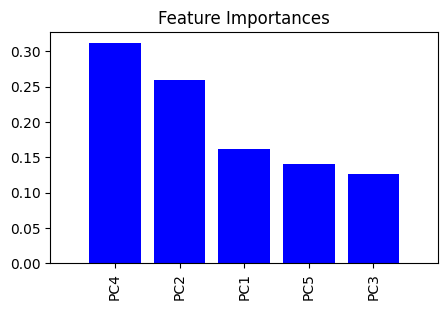

In [ ]:
importances = best_model.feature_importances_

indices = np.argsort(importances)[::-1]

plt.figure(figsize=(5, 3))
plt.title("Feature Importances")
plt.bar(range(X_train.shape[1]), importances[indices],
       color="b", align="center")
plt.xticks(range(X_train.shape[1]), X_train.columns[indices], rotation=90)
plt.xlim([-1, X_train.shape[1]])
plt.show()

In the simulation from the SHAP library it can be seen that the most important componenys are the components that also contributed a lot to wrong observations. But if we omit them we will also lose the precision they brought us to.

If so, maybe the problem is with this particular data. Because we see that using PC2 and PC4 components most of the observations were correctly classified. whereas the problem is only with certain observations.